# Audio separation with unsupervised learning (NMF + Clustering)

In this project I will explore how unsupervised learning algorithms can be used for audio processing. In particular, I will split an audio sample into separate audio tracks, one for each instrument.

Working with audio can be challenging, but since there exists a quite precise numerical representation of a sound, I will transform the audio sample into a dataset, then I will apply NMF to split it into components, and then I will cluster the components into groups (per instrument). The process contains a few more steps, so I'll outline the complete workflow:

![workflow](workflow.png)

Github repository: https://github.com/alexber2024/audio-separation

## 1. Data and EDA

For this project I will be using a single audio file as my data source. It's a 22 seconds music sample, taken from CapCut free music library (Night City Jazz). The file format is mp3, which is a compressed waveform. First I will need to load the file:

(I will use librosa package for processing audio data througout this project, and IPython to play the audio)

In [1]:
import librosa
import IPython
import numpy as np
from matplotlib import pyplot as plt
from sklearn.decomposition import NMF
from sklearn.cluster import KMeans


# load the audio file
x, sr = librosa.load('audio.mp3', sr=None)  # sr=None to keep the original sampling rate

# play the audio file
IPython.display.Audio(data=x, rate=sr)

We can hear 5 main instruments in this sample: saxophone, piano, guitar, bass and drums. My goal will be creating a separate audio track for each of these instruments. But first, I will need to transform the audio file into a dataset.

Initially I have 2 variables from librosa.load() command:
* x - this is the waveform of the audio. It is simply a 1-dimensional array of an amplitude (sound strength) over time
* sr - sample rate. This is actually the digitalization of a sound, the number of samples per second

In [2]:
print(x.shape)
print(sr)

(1004544,)
44100


So the sample rate is 44100 per second, and waveform contains 1004544 values, which correspond to 22 seconds.

Here is the plot of the waveform (amplitude over time):

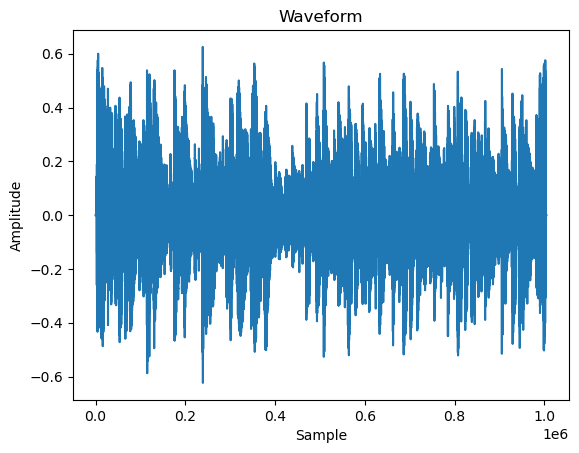

In [3]:
plt.plot(x)
plt.title('Waveform')
plt.xlabel('Sample')
plt.ylabel('Amplitude')
plt.show()

This data doesn't have much meaning in it's current form, and I will only perform some basic checks, to see that there are no outliers, and will also plot the histogram. The data looks very clean and distributed simetrically over 0.

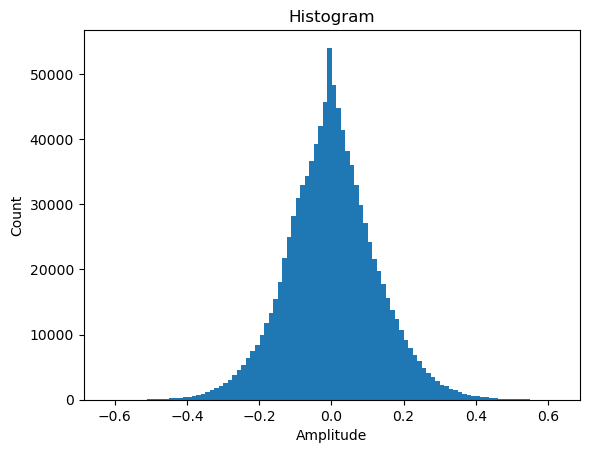

Max: 0.62524235
Min: -0.62378466


In [4]:
plt.hist(x, bins=100)
plt.title('Histogram')
plt.xlabel('Amplitude')
plt.ylabel('Count')
plt.show()

# check outliers
print('Max:', np.max(x))
print('Min:', np.min(x))

Now it's time to transform the data into a more meaningfull structure. And that's where the magic of frequencies comes in. The nature of a sound is based on waves, and those are the frequencies and combinations of them, that create the reachness of different sounds, pitches, harmony and etc. Luckily, there is a way to extract frequencies from waveform data. This is the Fourier Transform, or more specifically the Short-time Fourier Transform

In [8]:
# Short-time Fourier Transform (STFT) is an adaptation of Fourier Transform to time-evolving sounds. It splits the signal into small
# time frames, and computes the Fourier Transform for each frame.
stft = librosa.stft(x, n_fft=1024)

print(stft.shape)

# example of a single frequency bin in a single frame
print(stft[200, 102])

(513, 3925)
(0.0070207953+0.004084578j)


The above code creates the frequencies over time data. It has 513 frequency bins and 3925 time frames. The values are complex numbers. This dataset has much more information than the original audio signal, and I will use it for NMF. But before that, I will plot the data as a spectrogram, which is a common way to visualize the STFT data.

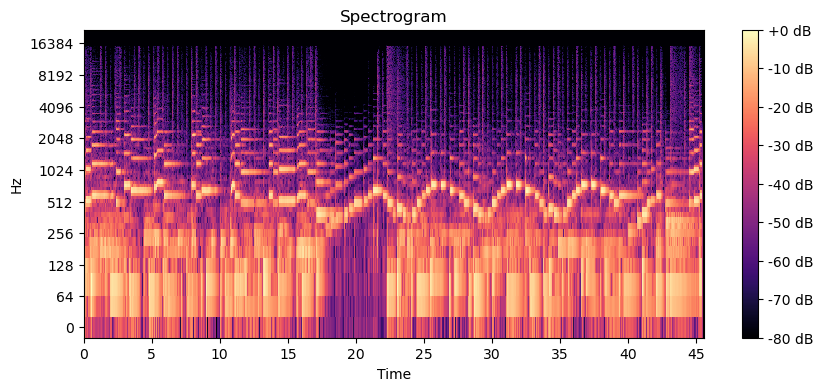

In [9]:
# amplitude of the STFT values (the magnitude of the complex numbers)
amp = np.abs(stft)

# phase of the STFT values (the angles of the complex numbers). I will need it later to reconstruct the signal.
phase = np.angle(stft)

# plot the spectrogram
plt.figure(figsize=(10, 4))
librosa.display.specshow(librosa.amplitude_to_db(amp, ref=np.max), y_axis='log', x_axis='time', sr=sr)
plt.colorbar(format='%+2.0f dB')
plt.title('Spectrogram')
plt.show()

The spectrogram shows signal strength for frequencies over time. It can reveal some important details about the audio sample. For example, in the middle we can see a region where lower and higher frequencies are mostly silent and only the middle range of frequencies are audible. That corresponds to a pause in the middle of the track.
What's important to note here, is that musical instruments are producing sounds that involve several frequencies in paralel, even if it sound like a single note. So in the middle range of the frequencies we see the main melody, first played by a saxophone and then continued by piano. And one of the foreseen problem for my following analysis is that the frequencies of these two instruments are very similar, and partially overlap.

Below I will plot 6 examples of frequency bins amplitude over time.

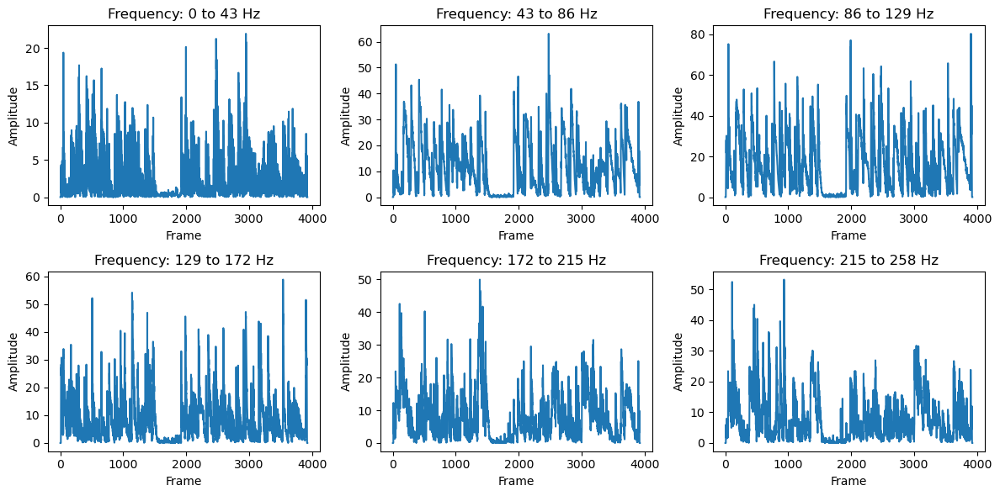

In [10]:
# get the frequecy bins
freqs = librosa.fft_frequencies(sr=sr, n_fft=1024)

# plot the amplitude of the first 6 frequency bins side by side
plt.figure(figsize=(12, 6))
for i in range(6):
    plt.subplot(2, 3, i + 1)
    plt.plot(amp[i])
    plt.title(f'Frequency: {freqs[i]:.0f} to {freqs[i + 1]:.0f} Hz')
    plt.xlabel('Frame')
    plt.ylabel('Amplitude')
plt.tight_layout()
plt.show()


The whole range of frequencies is from 0 to 22,000, which covers the audible range for the human ear:

In [12]:
min(freqs), max(freqs)

(0.0, 22050.0)

Now, lets see the correlation between frequency bins. The number of frequency bins is very high (513), but I will take only the first 100 bins, which will cover the frequency range up to 4300 Hz. This range includes most of the instruments sounds, while higher ranges are being produced by percussion instruments like cymbals.

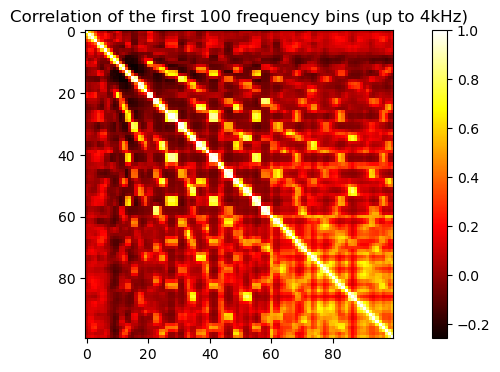

In [31]:
plt.figure(figsize=(10, 4))
plt.imshow(np.corrcoef(amp[0:100]), cmap='hot', interpolation='nearest')
plt.colorbar()
plt.title('Correlation of the first 100 frequency bins (up to 4kHz)')
plt.show()

The correlation matrix shows an interesting picture. There is a very high correlation between some of the frequency bins, which highlights the characteristic of musical instruments - when piano or saxophone plays a sound it produces multiple frequencies in parallel. The appearance of straight lines in the diagram, other than the diagonal, is probably explained by pitch range of a melody, so the relation between parallel frequencies is preserved across bins.

All this suggests a complex relationship between various frequencies, and this will make the separation task harder.

I want to add at this point, that I didn't do any cleaning of the data. The audio file is in a good quality, and I want to preserve the original music for my analysis. I will do some cleaning at later stage for another purpose, but for now, my data is ready for the NMF.

To sum up this section, I transformed my audio file into a dataset of frequecies over time, and now I can use machine learning models on this data.

## 2. Models

The central part of my analysis is about applying NMF on STFT data, with a hypothesis that matrix factorization will result in components which correspond to specific instruments. The optimal number of components will be probably larger than 5, because of the complexity of this audio sample. But due to the additive nature of the components, I will be able to add them into 5 groups and reconstruct the signals.
It's also important to check the reconstructed audio of the whole matrix to make sure the NMF approximation error is minimal

I'll start with an example of 5 components:

In [32]:
# decompose the spectrogram
nmf = NMF(n_components=5, init='random', random_state=0, max_iter=1000, solver='mu', beta_loss='kullback-leibler')
W = nmf.fit_transform(amp)
H = nmf.components_

In [33]:
# reconstruct and get the error
reconstructed = np.dot(W, H)
error = np.mean((amp - reconstructed)**2)
print(f'Error: {error}')

Error: 1.6118295192718506


In [34]:
# play reconstructed audio
reconstructed_stft = reconstructed * np.exp(1j * phase) # combine the amplitude and phase
reconstructed_audio = librosa.istft(reconstructed_stft) # inverse STFT
IPython.display.Audio(data=reconstructed_audio, rate=sr)

The quality of the reconstructed audio is very low, which means 5 components are too few for a NMF. I will do a quick hyperparameter optimization, checking the error for a different number of components:

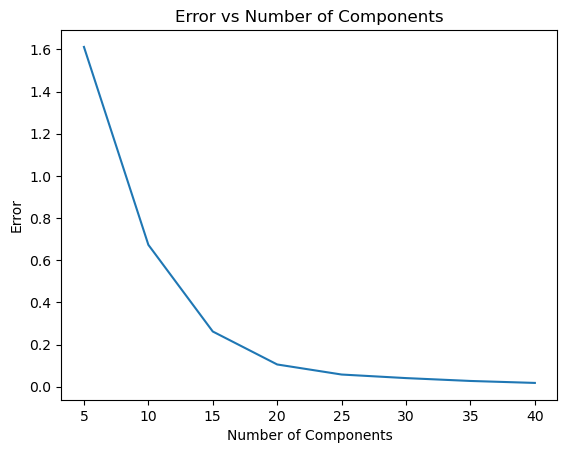

In [35]:
errors = []
for n in range(5,41,5):
    nmf = NMF(n_components=n, init='random', random_state=0, max_iter=1000, solver='mu', beta_loss='kullback-leibler')
    W = nmf.fit_transform(amp)
    H = nmf.components_
    reconstructed = np.dot(W, H)
    error = np.mean((amp - reconstructed)**2)
    errors.append(error)

plt.plot(range(5, 41, 5), errors)
plt.title('Error vs Number of Components')
plt.xlabel('Number of Components')
plt.ylabel('Error')
plt.show()


It looks like having around 30 components would make sense. Higher values don't bring the error much lower.

In [36]:
n_components=30
nmf = NMF(n_components=n_components, init='random', random_state=0, max_iter=1000, solver='mu', beta_loss='kullback-leibler')
W = nmf.fit_transform(amp)
H = nmf.components_

# reconstruct and get the error
reconstructed = np.dot(W, H)
error = np.mean((amp - reconstructed)**2)
print(f'Error: {error}')

# play reconstructed audio
reconstructed_stft = reconstructed * np.exp(1j * phase)
reconstructed_audio = librosa.istft(reconstructed_stft)
IPython.display.Audio(data=reconstructed_audio, rate=sr)

Error: 0.04063262417912483


Sounds good enough. Next, I want to reconstruct the audio for each component

In [37]:
reconstructed = []
stft_components = []
for i in range(n_components):
    # reconstruct the spectrogram for the i-th component
    amp_reconstructed = W[:, i].reshape(-1, 1) @ H[i, :].reshape(1, -1)
    stft_components.append(amp_reconstructed)
    # reconstruct the signal
    stft_reconstructed = amp_reconstructed * np.exp(1j * phase)
    

    # inverse the stft with librosa
    x_reconstructed = librosa.istft(stft_reconstructed)
    reconstructed.append(x_reconstructed)


Now I have a reconstructed audio for 30 components. I will plot the signals.

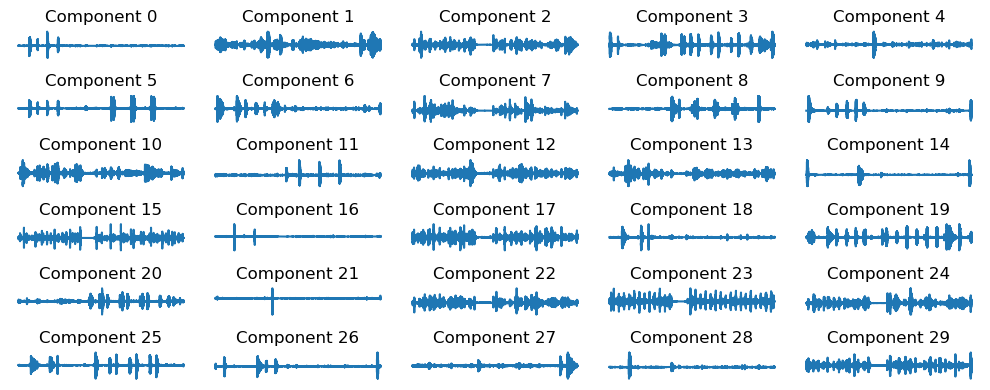

In [38]:
plt.figure(figsize=(10, 4))
for i in range(n_components):
    plt.subplot(6, 5, i + 1)
    plt.plot(reconstructed[i])
    plt.title(f'Component {i}')
    plt.axis('off')
plt.tight_layout()
plt.show()

And here are some samples of reconstructed components

In [39]:
for i in range(5):
    IPython.display.display(IPython.display.Audio(data=reconstructed[i+1], rate=sr))

After hearing all the 30 components, I manually grouped them into 5 categories (instruments). Below are the results of the separated audio tracks after reconstructing and adding the components in each group:

In [40]:
combinations = {
    'Saxophone': [0, 6, 9, 14, 16, 18, 26],
    'Piano': [4, 3, 5, 8, 11, 19, 20, 25, 27],
    'Guitar': [1, 10, 12, 13, 17],
    'Bass': [2, 7, 22, 24, 29],
    'Drums': [15, 23]
}

for instrument, combination in combinations.items():
    comb = np.sum([reconstructed[j] for j in combination], axis=0)
    print(f'{instrument}: {combination}')
    IPython.display.display(IPython.display.Audio(data=comb, rate=sr))


Saxophone: [0, 6, 9, 14, 16, 18, 26]


Piano: [4, 3, 5, 8, 11, 19, 20, 25, 27]


Guitar: [1, 10, 12, 13, 17]


Bass: [2, 7, 22, 24, 29]


Drums: [15, 23]


These results show a good separation for drums, bass and guitar tracks. The saxophone and piano tracks slightly overlap, as predicted.

But I need the whole process to be automated, so I will build a model for clustering the NMF components and see how it compares with manual clustering.

To improve the clustering performance I will clean the data, and transform it into another structure (MFCC). This will not affect the final tracks, because I will use the original reconstructed components for that, so the clustering will only show me their indexes.

One of the useful cleaning approaches is taking only harmonic part of the signals and stripping all noise:

In [41]:
reconstructed_hpss = [librosa.effects.hpss(x)[0] for x in reconstructed]

Next, I will transform each of the reconstructed components into a MFCC format. This is another representation of an audio signal which makes it easier to compare sounds.

In [42]:
mfcc_features = np.array([librosa.feature.mfcc(y=x, sr=sr, n_mfcc=20) for x in reconstructed_hpss])
mfcc_features = mfcc_features.reshape(mfcc_features.shape[0], -1)

Now I can run the clustering. I will use a simple KMeans model with 5 clusters. And then I'll create the combined audio track from components of each cluster.

In [43]:
n_clusters = 5
kmeans = KMeans(n_clusters=n_clusters, random_state=5)
labels = kmeans.fit_predict(mfcc_features)

# I will keep the indices to compare it with manual 
combinations_cl = []
for i in range(n_clusters):
    combinations_cl.append(np.where(labels == i)[0])

combined = [np.zeros_like(reconstructed[0]) for _ in range(n_clusters)]
for i, label in enumerate(labels):
    combined[label] += reconstructed[i]

# play the combined audio
for i in range(n_clusters):
    IPython.display.display(IPython.display.Audio(data=combined[i], rate=sr))

And finally, I will compare the KMean clustering results with manual clustering. I will use the Jaccard similarity between two sets (in my case the sets are the reconstructed NMF components for each instrument). I will define the final accuracy of the clustering as the average similarity across all 5 instruments.

In [45]:
def jaccard_similarity(list1, list2):
    set1, set2 = set(list1), set(list2)
    intersection = len(set1 & set2)
    union = len(set1 | set2)
    return intersection / union if union != 0 else 0

jaccs = []
for instrument, combination in combinations.items():
    print(instrument)
    print(f'- Manual: {combination}')
    hits = 0
    best = i
    for i, comb_cl in enumerate(combinations_cl):
        hit = len(set(comb_cl) & set(combination))
        if hit > hits:
            hits = hit
            best = i
    jacc = jaccard_similarity(combination, combinations_cl[best])
    jaccs.append(jacc)
    print(f'- Clustering: {list(combinations_cl[best])}', f'Jaccard: {jacc}')
    print('')

print(f'Average Jaccard: {np.mean(jaccs)}')


Saxophone
- Manual: [0, 6, 9, 14, 16, 18, 26]
- Clustering: [0, 4, 6, 9, 16, 18, 21] Jaccard: 0.5555555555555556

Piano
- Manual: [4, 3, 5, 8, 11, 19, 20, 25, 27]
- Clustering: [3, 5, 8, 11, 14, 19, 20, 25, 26, 27, 28] Jaccard: 0.6666666666666666

Guitar
- Manual: [1, 10, 12, 13, 17]
- Clustering: [1, 10, 12, 13, 17] Jaccard: 1.0

Bass
- Manual: [2, 7, 22, 24, 29]
- Clustering: [2, 7, 22, 24, 29] Jaccard: 1.0

Drums
- Manual: [15, 23]
- Clustering: [15, 23] Jaccard: 1.0

Average Jaccard: 0.8444444444444444


## 3. Results and Discussion

The results show a precise clustering for piano, guitar and bass components. However, the saxophone and piano Jaccard similarity is 0.55 and 0.66 respectively. The final average similarity is 0.84, which shows that the model provide good accuracy for sound separation, considering the overlapping nature of piano and saxophone frequencies. 

In conclusion, I can say that my hypotesis was partially correct. The NMF model indeed provided components, mostly corresponding to different instruments. It works best for instruments which have non-overlapping frequencies.

In order to improve the separation quality further, I think a more complex approach would be needed. The clusters of the NMF components would probably need to be allowed to overlap, in order to include the full spectrum of each instrument. But then I would need to find a way to remove non-relevant parts. Maybe a time based separation will work for that, in addition to frequency separation. Also, having a pre-trained model for each instrument can help distinguishing the exact frequencies for each cluster.

Finally, I can say that this project was an amazing opportunity for me to learn about the basics of audio analysis, exploring the different tools, and applying unsupervised learning models on audio data. I was excited to find out that audio processing can be done entirely in python, using numerical methods, especially the machine learning techniques, and then recreating audio tracks from data.

## References
* librosa Python library: https://librosa.org/doc/latest/index.html
* Waveform: https://en.wikipedia.org/wiki/Waveform
* Audio frequency: https://en.wikipedia.org/wiki/Audio_frequency
* Spectrogram: https://en.wikipedia.org/wiki/Spectrogram
* Short-time Fourier Transform: https://en.wikipedia.org/wiki/Short-time_Fourier_transform
* MFCC: https://en.wikipedia.org/wiki/Mel-frequency_cepstrum